# installs

In [2]:
!python --version

Python 3.7.15


In [3]:
# !pip install line_profiler

In [4]:
# %load_ext line_profiler

In [5]:
# !pip install memory_profiler

In [6]:
# %load_ext memory_profiler

In [7]:
# !pip install pycodestyle_magic

In [8]:
# %load_ext pycodestyle_magic

In [9]:
import matplotlib
matplotlib.__version__

'3.2.2'

In [10]:
# !pip install -U matplotlib
#!pip install matplotlib==3.2.4

In [11]:
!pip install geopandas
!pip install geopy
#!pip install alphashape
!pip install pygeos
!pip install h3
!pip install h3pandas

!pip install fiona 
!pip install shapely 
!pip install pyproj 
!pip install rtree

!pip install folium
!pip install missingno
!pip install sparklines
!pip install mapclassify

!pip install scikit-learn
# !pip install osmnx
# !pip install networkx

# !pip install osmnx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 5.3 MB/s 
     |████████████████████████████████| 16.7 MB 28.6 MB/s 
     |████████████████████████████████| 6.3 MB 48.7 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.1 MB 5.0 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 5.1 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 75 kB 2.2 MB/s 
  Created wheel for h3pandas: filename=h3pandas-0.2.3-py3-none-any.whl size=17136 sha256=bcef4b250491c0b75dfa37ad90bc920ac753e2d47b09ab47dbac6a562fd37bc4
  Store

In [12]:
%%bash
VAR_SEARCH='h3|pandas|shapely|geopandas'
pip3 freeze | grep -E $VAR_SEARCH

geopandas==0.10.2
h3==3.7.4
h3pandas==0.2.3
pandas==1.3.5
pandas-datareader==0.9.0
pandas-gbq==0.17.9
pandas-profiling==1.4.1
sklearn-pandas==1.8.0


# imports

In [13]:
import warnings
warnings.filterwarnings('ignore')

In [14]:
from IPython.core.display import HTML
from IPython.display import Image, display
from IPython.utils.text import columnize
from IPython.display import clear_output

from google.colab import data_table

import os
import os.path
from pathlib import Path

from functools import partial
from collections import defaultdict
from itertools import takewhile
import more_itertools as mit
from operator import or_
from functools import reduce

import contextlib

import random
import datetime as dt
import time

from timeit import default_timer
from tqdm import tqdm

import math

# import gc
# import ctypes
# from multiprocessing import Process, Event, Value
# import psutil
import sys
from sys import getsizeof
import shutil
import tempfile

# import logging

import pickle
# import joblib
import gzip

import numpy as np
import pandas as pd
from pandas.api.types import is_numeric_dtype
from pandas.testing import assert_frame_equal

import geopandas as gpd

import h3pandas

from shapely.geometry import Polygon, Point, MultiPolygon
from shapely.ops import polygonize, unary_union
from shapely import wkt

# import alphashape
# from descartes import PolygonPatch

import matplotlib
import matplotlib.pyplot as plt
import matplotlib_venn as venn
import seaborn as sns

from sklearn.metrics import mean_squared_error, mean_absolute_error

# import statistics
from h3 import h3

import pygeos

import folium
from folium.plugins import HeatMap

import missingno as msno
from sparklines import sparklines
# import osmnx as ox


# import osmnx as ox
# import networkx as nx

# settings

In [15]:
# https://colab.research.google.com/notebooks/data_table.ipynb#scrollTo=jcQEX_3vHOUz
data_table.enable_dataframe_formatter()

In [16]:
np.set_printoptions(precision=4)
np.set_printoptions(suppress=True)

In [17]:
pd.set_option('max_colwidth', 512)
pd.set_option('display.max_columns', 64)
pd.set_option('display.max_rows', 108)
pd.set_option('display.precision', 5)
pd.set_option('float_format', '{:,.5f}'.format)
pd.options.mode.chained_assignment = None

In [18]:
plt.style.use('seaborn')

In [19]:
sns.set(context='notebook', style='darkgrid', palette='deep', font='sans-serif', font_scale=1, color_codes=False, rc=None)

In [20]:
N_JOBS = os.cpu_count()
RANDOM_STATE = 42

In [21]:
DATE_TIME_FORMAT = '%Y-%m-%d %H:%M:%S'

In [22]:
COLAB = 1
USE_GDRIVE = 2
run_mode = {
    COLAB: True,
    USE_GDRIVE: True,
}
VERBOSE = 0

In [23]:
random.seed(RANDOM_STATE)
np.random.seed(RANDOM_STATE)
os.environ['PYTHONHASHSEED'] = str(RANDOM_STATE)

## dirs

In [24]:
# LOGGING_DIR='logs'
GOOGLE_DRIVE_DIR = '/content/drive/MyDrive/pm'

In [25]:
dirs = {
    'cache': 'cache',
    'preprocessed': 'preprocessed',
    'source': 'source',
    'img': 'img',
    'osm': 'osm',
    'train': 'train',
    'temp': None,
}
for d, p in dirs.items():
    if not p:
        dirs[d] = tempfile.mkdtemp(prefix=f'tmp_{dt.datetime.utcnow().strftime("%Y%m%d_%H-%M-%S")}', dir='.')
    else:
        os.makedirs(p, exist_ok=True)

In [26]:
save_dirs = {
    'cache': [False, True], # import/export
    'preprocessed': [False, False],
    'source': [True, False],
    'img': [False, True],
    'osm': [False, False],
    'train': [False, True],
    'temp': [False, False],
}


## logging

In [27]:
# #logging.basicConfig(level=logging.INFO)
# os.makedirs(LOGGING_DIR, exist_ok=True)
# logging.basicConfig(
#     level=logging.DEBUG,
#     format='[{%(filename)s:%(lineno)d} %(levelname)s - %(message)s',
#     force=True,
#     handlers=[
#         logging.FileHandler(filename=f'{LOGGING_DIR}/ts_{dt.datetime.utcnow().strftime("%Y%m%d_%H-%M-%S")}.log', mode='w'),
#         logging.StreamHandler()
#     ]
# )
# logger = logging.getLogger(__name__)

In [28]:
# logger.info('start logging')

## moscow specific

In [29]:
MOSCOW_CENTER_POINT = (55.756261, 37.617731)
MOSCOW_CRS = f'+proj=tmerc +lat_0={MOSCOW_CENTER_POINT[0]} +lon_0={MOSCOW_CENTER_POINT[1]} +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'
# '+proj=tmerc +lat_0=55.6666666667 +lon_0=37.5 +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'


## osm

In [30]:
WGS84_CRS = 4326

In [31]:
MAP_ZIP_FILE_PATH = f'{dirs["source"]}/RU-MOW-ccef5f5b-20221028-ru-shape.zip' #RU-MOW-ccef5f5b-20221028-ru-shape.zip
MAP_ZIP_LAYER_PATH = f'zip://{MAP_ZIP_FILE_PATH}!data/'

In [32]:
gdf_map = dict()

# colab with gdrive

In [33]:
run_mode[COLAB] = run_mode[USE_GDRIVE] = True

In [34]:
!ls source

In [35]:
if run_mode[USE_GDRIVE]:
  try:
      from google.colab import drive
      print('working in colab')
      run_mode[COLAB] = True    
      drive.mount('/content/drive')
      print('\tdrive mounted')
      if os.path.exists(GOOGLE_DRIVE_DIR):
        print('\tgdrive wd exists')
        run_mode[USE_GDRIVE] = True
        for d, rules in save_dirs.items():
            if rules[0]:
                d = dirs[d]
                !cp -ruv '{GOOGLE_DRIVE_DIR}/{d}' .
        print('\tcp - done')
        !ls -la
  except:
    print('no colab')
    run_mode[COLAB] = False
    run_mode[USE_GDRIVE] = False

working in colab
Mounted at /content/drive
	drive mounted
	gdrive wd exists
'/content/drive/MyDrive/pm/source/RU-MOW-ccef5f5b-20221028-ru-shape.zip' -> './source/RU-MOW-ccef5f5b-20221028-ru-shape.zip'
'/content/drive/MyDrive/pm/source/070922_вход по встанциям.csv' -> './source/070922_вход по встанциям.csv'
'/content/drive/MyDrive/pm/source/060922_вход по встанциям.csv' -> './source/060922_вход по встанциям.csv'
'/content/drive/MyDrive/pm/source/080922_вход по встанциям.csv' -> './source/080922_вход по встанциям.csv'
'/content/drive/MyDrive/pm/source/130922_вход по встанциям.csv' -> './source/130922_вход по встанциям.csv'
'/content/drive/MyDrive/pm/source/metro_entrance_stats_20220915.csv' -> './source/metro_entrance_stats_20220915.csv'
'/content/drive/MyDrive/pm/source/join_metro_pass_geo.csv' -> './source/join_metro_pass_geo.csv'
'/content/drive/MyDrive/pm/source/140922_вход по встанциям.csv' -> './source/140922_вход по встанциям.csv'
'/content/drive/MyDrive/pm/source/houses_pm_v10.xl

# defs

## io

In [36]:
def savepoint():
    for d, rules in save_dirs.items():
        if rules[1]:
            d = dirs[d]
            !cp -ruv '{d}' '{GOOGLE_DRIVE_DIR}/'

In [37]:
def fp(b, fn):
    return str(Path(dirs[b], fn))

In [38]:
def save_as_geojson(gdf, fn, b='cache', zip=True, save=True):
    file_path = fp(b, f'{fn}.geojson')
    gdf.to_file(file_path, driver='GeoJSON')
    !zip '{file_path}.zip' '{file_path}'
    if save:
        savepoint()

## pandas

In [39]:
def rename_func(name):
    def decorator(func):
        func.__name__ = name
        return func
    return decorator

def q_at(y):
    @rename_func(f'q{y:0.2f}')
    def q(x):
        return x.quantile(y)
    return q

In [40]:
def sparkline_str(x, excludes=('key',)):
    return ''.join(sparklines(np.histogram(x.dropna())[0])) if is_numeric_dtype(x) and x.name not in excludes else ''

In [41]:
def describe(
    df,
    caption = '',
    quantiles=(.5,),
    format_dict = {
        'uniques#':'{0: .0f}', 
        'count':'{0: .0f}',
        #'mean':'{0: .2f}',
        #'std':'{0: .2f}',
        #'date': '{:%m-%Y}', 
        'nulls%': '{:.2%}',
        'nulls#': '{:.0f}',    
    },
):
    # pandas describe method substitution
    return (
        df.dtypes.to_frame('dtype')
            .join(
                df.nunique(dropna=True).to_frame('uniques#')
            )
            .join(
                df.isnull().agg(['mean', 'sum']).T.rename(columns = {'mean': 'nulls%', 'sum': 'nulls#'})
            )
            .join(
                df.apply(sparkline_str).to_frame('hist')
            )    
            .join(
                df.agg([
                    'count', 
                    'mean', 
                    'std',
                    #'skew',
                    'min',
                    'max',
                    *[q_at(i) for i in quantiles],
                    ]).T
            )
            .style
                .format(format_dict)
                #.hide_index()
                .bar(color='skyblue', vmin=0, vmax=df.shape[0], subset=['uniques#'], align='zero')        
                .bar(color='pink', vmin=0, vmax=1, subset=['nulls%'], align='zero')
                .bar(color='pink', vmin=0, vmax=df.shape[0], subset=['nulls#'], align='zero')
                .set_caption(caption)   
    )

In [42]:
def print_value_counts(ds, ascending=False, dropna=False, normalize=False, greater_than=0, width=100):
    print(
        columnize(
            ds.value_counts(
                ascending=ascending,
                dropna=dropna,
                normalize=normalize,
            ).loc[lambda s: s > greater_than].to_frame().reset_index().astype('str').agg(' - '.join, axis=1).tolist(),
            displaywidth=width,
        )
    )

## geopandas

In [43]:
def as_gdf_with_points(df, lon='lon', lat='lat', crs=WGS84_CRS):
    return gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df[lon], df[lat], crs=WGS84_CRS),
        crs=WGS84_CRS
)


In [44]:

@contextlib.contextmanager
def set_to_crs(gdfs, crs=WGS84_CRS):
    if not isinstance(gdfs, tuple):
        gdfs = (gdfs,)
    init_crss = []
    for gdf in gdfs:
        init_crss.append(gdf.crs)
        gdf.to_crs(crs, inplace=True)
    try:
        yield gdfs
    finally:
        for i, gdf in enumerate(gdfs):
            gdf.to_crs(init_crss[i], inplace=True)


## map_layer_reduced

In [45]:
def reduced_layer(
    gdf_map, 
    layer_key, 
    boundary_key = None,
    layer_file = None,
    reduced_layer_file_parquet = None,
    mode='within',
    map_dir=dirs['source'], 
    zip_root=MAP_ZIP_LAYER_PATH,
    reload=False,
):
    reduced_layer_key = f'{layer_key}_{boundary_key}' if boundary_key else layer_key
    if reload and reduced_layer_key in gdf_map:
        del gdf_map[reduced_layer_key]

    if reduced_layer_key in gdf_map:
        print('loaded from cache')
        return gdf_map[reduced_layer_key]

    reduced_layer_file_parquet = reduced_layer_file_parquet if reduced_layer_file_parquet else reduced_layer_key
    file_path_parquet = fp('cache', f'{reduced_layer_file_parquet}.parquet')
    if os.path.isfile(file_path_parquet):
        print(f'reduced [{reduced_layer_key}] loaded from {file_path_parquet}')
        gdf_map[reduced_layer_key] = gpd.read_parquet(file_path_parquet)
        return gdf_map[reduced_layer_key]

    if layer_key not in gdf_map:
        layer_file = layer_file if layer_file else layer_key.replace('_', '-')
        layer_file += '.shp'
        zip_path = f'{zip_root}{layer_file}'
        gdf_map[layer_key] = gpd.read_file(zip_path, encoding='utf-8')
        print(f'original [{layer_key}] loaded from {zip_path}')
        
    if not boundary_key:
        return gdf_map[layer_key]

    gdf = gdf_map[layer_key].copy()
    gdf.geometry = gdf.apply(lambda r: unary_union(r.geometry), axis=1)

    boundary = gdf_map[boundary_key]
    if hasattr(boundary, 'geometry'):
        boundary = boundary.geometry.unary_union
    if mode == 'within':
        gdf.drop(
            gdf[~gdf.geometry.within(boundary)].index,
            axis='index',
            inplace=True
        )
    elif mode == 'intersect':
        gdf.geometry = gdf.geometry.intersection(boundary)
        gdf.drop(
            gdf[gdf.is_empty].index,
            axis='index',
            inplace=True                
        )
    gdf_map[reduced_layer_key] = gdf
    gdf.to_parquet(file_path_parquet) # gdf.to_file(fn, driver='GeoJSON') 

    return gdf

# datasets

## wiki ao region stat 2022
- [Административно-территориальное деление Москвы](https://ru.wikipedia.org/wiki/%D0%A0%D0%B0%D0%B9%D0%BE%D0%BD%D1%8B_%D0%B8_%D0%BF%D0%BE%D1%81%D0%B5%D0%BB%D0%B5%D0%BD%D0%B8%D1%8F_%D0%9C%D0%BE%D1%81%D0%BA%D0%B2%D1%8B)

In [46]:
# !ls '{dirs["source"]}'/wiki*.csv

In [47]:
df_ao = pd.read_csv(
    fp('source', 'wiki_stat2022_ao.csv'),
    delimiter=';',
)
display(df_ao)
display(df_ao.info())

,ao_code,ao_name,area_km2_2012,population_2022,population_density_2022
0,ЦАО,Центральный,66.18000,779086,"11,773.03000"
1,САО,Северный,113.73000,1175229,"10,333.86000"
2,СВАО,Северо-Восточный,101.88000,1427597,"14,012.12000"
3,ВАО,Восточный,154.84000,1514420,"9,780.83000"
4,ЮВАО,Юго-Восточный,117.56000,1432839,"12,188.18000"
5,ЮАО,Южный,131.77000,1773425,"13,458.19000"
6,ЮЗАО,Юго-Западный,111.36000,1442971,"12,957.46000"
7,ЗАО,Западный,153.03000,1383853,"9,042.76000"
8,СЗАО,Северо-Западный,93.28000,1009217,"10,819.11000"
9,ЗелАО,Зеленоградский,37.20000,253687,"6,819.56000"


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ao_code                  12 non-null     object 
 1   ao_name                  12 non-null     object 
 2   area_km2_2012            12 non-null     float64
 3   population_2022          12 non-null     int64  
 4   population_density_2022  12 non-null     float64
dtypes: float64(2), int64(1), object(2)
memory usage: 608.0+ bytes


None

In [48]:
df_rs = pd.read_csv(
    fp("source", 'wiki_stat2022_region.csv'),
    delimiter=';',
)
display(df_rs.sample(5))
display(df_rs.info())

,id,region_name,ao_code,okato,oktmo,area_km2_2012,population_2022,population_density_2022,avr_living_m2_per_person_2010
44,112,Хорошёвский,САО,45277598000,45348000,9.88000,70970,"7,183.20000",38.20000
47,6,Бабушкинский,СВАО,45280556000,45351000,5.07000,88092,"17,375.15000",18.50000
4,25,Гольяново,ВАО,45263564000,45305000,14.99000,161126,"10,748.90000",19.10000
55,75,Отрадное,СВАО,45280574000,45359000,10.18000,185218,"18,194.30000",17.80000
26,106,Тропарёво-Никулино,ЗАО,45268592000,45327000,11.27000,122663,"10,884.03000",24.40000


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120 entries, 0 to 119
Data columns (total 9 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             120 non-null    int64  
 1   region_name                    120 non-null    object 
 2   ao_code                        120 non-null    object 
 3   okato                          120 non-null    int64  
 4   oktmo                          120 non-null    int64  
 5   area_km2_2012                  120 non-null    float64
 6   population_2022                120 non-null    int64  
 7   population_density_2022        120 non-null    float64
 8   avr_living_m2_per_person_2010  120 non-null    float64
dtypes: float64(3), int64(4), object(2)
memory usage: 8.6+ KB


None

In [49]:
df_rs[['okato', 'oktmo']] = df_rs[['okato', 'oktmo']].astype('str')

## map: RU-MOW-ccef5f5b-20221028-ru-shape
- https://wiki.openstreetmap.org/wiki/Map_features#Attributes
- https://docs.google.com/spreadsheets/d/e/2PACX-1vTAv39RP6hZWTaC8aU5vhXN64com_hN1ydLThPR0QvfDI6w0CHouYRnJrq7JSrn6xnKDdhTax23w4qd/pubhtml#

### layers preload

In [50]:
MAP_ZIP_FILE_PATH

'source/RU-MOW-ccef5f5b-20221028-ru-shape.zip'

In [51]:
!unzip -l $MAP_ZIP_FILE_PATH

Archive:  source/RU-MOW-ccef5f5b-20221028-ru-shape.zip
  Length      Date    Time    Name
---------  ---------- -----   ----
   758407  2022-10-28 00:50   data.qgs
     1273  2022-10-28 00:50   readme.md
    11524  2021-07-05 07:07   svg/sport/8ball_nicu_buculei_01.svg
     3002  2021-07-05 07:07   svg/sport/soccer.svg
     2483  2021-07-05 07:07   svg/sport/swimming.svg
     3680  2021-07-05 07:07   svg/sport/athletics.svg
     7332  2021-07-05 07:07   svg/sport/bicycle.svg
     4107  2021-07-05 07:07   svg/sport/shooting.svg
     6717  2021-07-05 07:07   svg/sport/carting.svg
     2656  2021-07-05 07:07   svg/sport/basketball.svg
     6704  2021-07-05 07:07   svg/sport/motorracing.svg
    12493  2021-07-05 07:07   svg/sport/volley_ball_angelo_gelmi_01.svg
    10309  2021-07-05 07:07   svg/sport/multi.svg
     6050  2021-07-05 07:07   svg/sport/equestrian.svg
     2852  2021-07-05 07:07   svg/sport/tennis.svg
    12662  2021-07-05 07:07   svg/sport/table_tennis.svg
     4764  2021-07-

In [52]:
LAYERS_DICT = {
    'boundary_L4': 'boundary-polygon-lvl4.shp', # границы города
    'boundary_L5': 'boundary-polygon-lvl5.shp', # административные округа
    'boundary_L8': 'boundary-polygon-lvl8.shp', # районы
    'building_polygon': 'building-polygon.shp',  # Здания, отмеченные в виде полигонов
    'highway_line': 'highway-line.shp', # дороги
}

for i, layer in enumerate(LAYERS_DICT.keys()):
    path_to_layer = MAP_ZIP_LAYER_PATH + LAYERS_DICT[layer]
    gdf_map[layer] = gpd.read_file(path_to_layer, encoding='utf-8')
    print(f'[{i+1}/{len(LAYERS_DICT)}] LOADED {layer}')

[1/5] LOADED boundary_L4
[2/5] LOADED boundary_L5
[3/5] LOADED boundary_L8
[4/5] LOADED building_polygon
[5/5] LOADED highway_line


### границы boundary-polygon-lvl4/5/8 

#### overview

In [ ]:
# describe(gdf_map['boundary_L5'])

In [ ]:
# describe(gdf_map['boundary_L8'])

In [ ]:
gdf_map['boundary_L8'].crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
_, (ax4, ax5, ax8) = plt.subplots(1, 3, figsize=(21,7))
gdf_map['boundary_L4'].plot(ax=ax4, color='white', edgecolor='black')
gdf_map['boundary_L5'].plot(ax=ax5, color='white', edgecolor='black')
gdf_map['boundary_L8'].plot(ax=ax8, color='white', edgecolor='black');

In [ ]:
base = gdf_map['boundary_L4'].plot(color='white', edgecolor='black', linewidth=6, figsize=(16,16))
base = gdf_map['boundary_L5'].plot(color='white', alpha=.5, edgecolor='blue', linewidth=4, ax=base);
gdf_map['boundary_L8'].plot(column='NAME_RU', alpha=.5, edgecolor='red', legend=True, linewidth=2, ax=base);

#### & stats

In [ ]:
gdf_map['boundary_L8'][gdf_map['boundary_L8']['oktmo'].isna()]

In [ ]:
gdf_map['boundary_L8'].loc[91, ['oktmo', 'okato']] = df_rs.query('region_name == "Бирюлёво Восточное"')[['oktmo', 'okato']].iloc[0].tolist() # 91 район Бирюлёво Восточное
gdf_map['boundary_L8'].loc[96, ['oktmo', 'okato']] = df_rs.query('region_name == "Бирюлёво Западное"')[['oktmo', 'okato']].iloc[0].tolist() # 96 район Бирюлёво Западное

In [ ]:
gdf_map['boundary_L8'].loc[[91, 96], ['oktmo', 'okato']]

In [ ]:
gdf_map['boundary_L8_base'] = (
    gdf_map['boundary_L8']
    [['oktmo', 'NAME_EN', 'NAME_RU', 'ADMIN_LVL', 'OSM_ID', 'ADMIN_L4D', 'ADMIN_L4', 'ADMIN_L5D', 'ADMIN_L5', 'geometry']]
    .merge(
        df_rs,
        how='inner',
        on='oktmo',    
    )
)

print(gdf_map['boundary_L8_base'].shape)
print(gdf_map['boundary_L8_base'].columns)
gdf_map['boundary_L8_base'].plot();

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(16,16))
#fig.subplots_adjust(right=0.8),
gdf_map['boundary_L8_base'].plot(
    column='population_density_2022', 
    edgecolor='blue',
    cmap='OrRd',
    #scheme='quantiles',
    linewidth=1, 
    ax=ax,
    #cax=cax,
    # legend_kwds={
    #     'label': "Плотность населения на 2022",
    #     'orientation': "horizontal",
    #     #'loc': 'upper left',
    #     #'bbox_to_anchor': (1, 1), 
    # },
).set(title='Плотность населения на 2022');
# ax.axis('off')
# # ax.annotate('Source: London Datastore, 2014',xy=(0.1, .08),  xycoords='figure fraction', horizontalalignment='left', verticalalignment='top', fontsize=12, color='#555555')
# #fig.tight_layout()
# #plt.show()

# sm = plt.cm.ScalarMappable(cmap='OrRd', norm=plt.Normalize(
#     vmin=gdf_map['boundary_L8_base'].population_density_2022.min(), 
#     vmax=gdf_map['boundary_L8_base'].population_density_2022.max()),
# )
# sm._A = []
# cbar = fig.colorbar(sm, ax=ax)

#### outer boundary

##### [base] with base regions (nearest to center)

In [ ]:
# region_osm_ids = gdf_map['boundary_L8_base']['OSM_ID'].tolist()
#dfm['boundary_L8_base'] = gdf_map['boundary_L8].query('OSM_ID in @region_osm_ids')

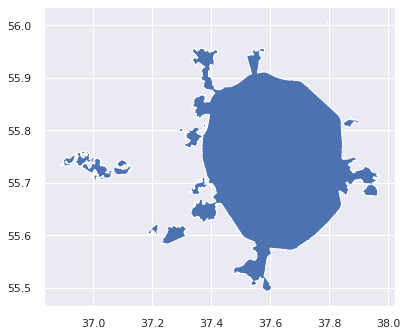

In [64]:
outer_regions_boundary_polygon = gdf_map['boundary_L8_base'].geometry.unary_union
gdf_rb = gpd.GeoDataFrame(geometry=[outer_regions_boundary_polygon], crs=gdf_map['boundary_L8_base'].crs)
gdf_rb.plot();

##### + [base2] base reduced

In [ ]:
bounds = ((37.4, 55.4), (38., 55.4), (38., 55.98), (37.15, 55.98), (37.15, 55.7), (37.4, 55.6))

In [ ]:
gdf_rb.geometry.intersection(Polygon(bounds)).plot();

In [67]:
gdf_map['base2_bounds'] = Polygon(bounds)

In [ ]:
gdf_map['base2'] = gdf_rb.geometry.intersection(Polygon(bounds))

In [69]:
gdf_map['boundary_L8_base2'] = gdf_map['boundary_L8_base'].copy()

In [70]:
gdf_map['boundary_L8_base2'].geometry = gdf_map['boundary_L8_base'].geometry.intersection(Polygon(bounds))
gdf_map['boundary_L8_base2'].shape

(120, 18)

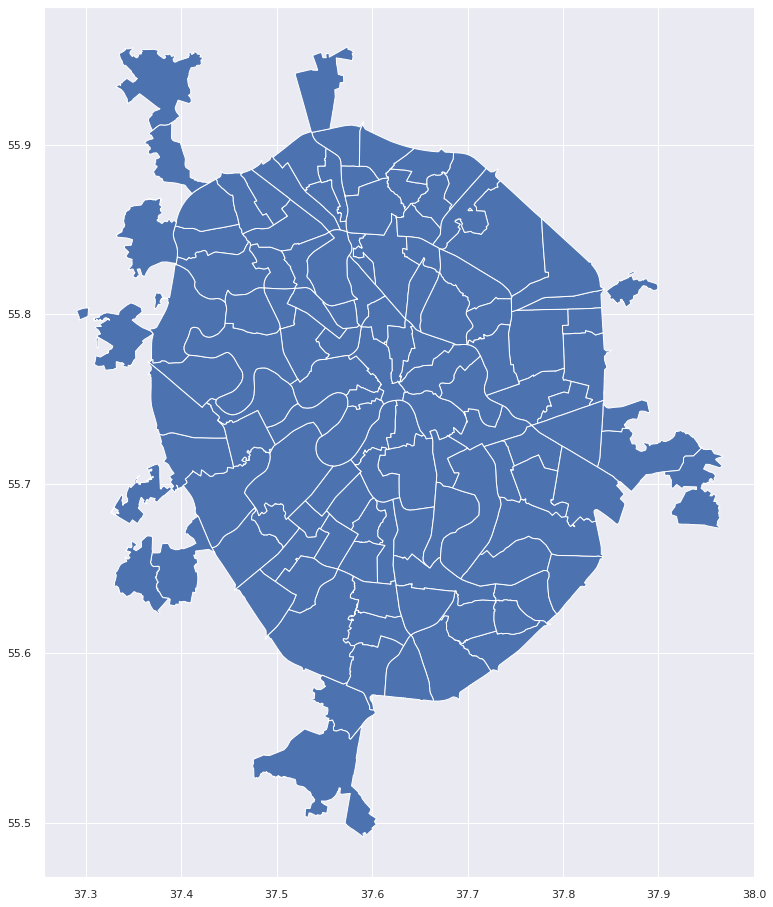

In [71]:
gdf_map['boundary_L8_base2'].geometry.plot(figsize=(16,16));

In [72]:
gdf_map['boundary_L8_base2'].drop(
    gdf_map['boundary_L8_base2'][gdf_map['boundary_L8_base2'].is_empty].index,
    inplace=True
)
gdf_map['boundary_L8_base2'].shape

(119, 18)

In [73]:
gdf_map['boundary_L8_base2']['centroid_x'] = gdf_map['boundary_L8_base2'].geometry.centroid.x
gdf_map['boundary_L8_base2']['centroid_y'] = gdf_map['boundary_L8_base2'].geometry.centroid.y
gdf_map['boundary_L8_base2']['map_area_km2'] = gdf_map['boundary_L8_base2'].geometry.to_crs(MOSCOW_CRS).geometry.area / 10**6


In [74]:
print('mae:', mean_absolute_error(gdf_map['boundary_L8_base2']['area_km2_2012'], gdf_map['boundary_L8_base2']['map_area_km2']))
print('rmse:', mean_squared_error(gdf_map['boundary_L8_base2']['area_km2_2012'], gdf_map['boundary_L8_base2']['map_area_km2'], squared=False))

mae: 0.38489267625940693
rmse: 1.077663883229269


In [75]:
# for index, row in gdf_map['boundary_L8_base2'].iterrows():
#     gdf = gdf_map['boundary_L8_base2'].to_crs(
#         f'+proj=tmerc +lat_0={row.centroid_y} +lon_0={row.centroid_x} +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'
#     )
#     gdf_map['boundary_L8_base2'].loc[index, 'map_area_km2'] = gdf.loc[index].geometry.area / 10**6

In [76]:
# import fiona
# fiona.supported_drivers

In [77]:
# gdf_map['boundary_L8_base2'].to_parquet(fp("cache", 'moscow_regions_base2.parquet'))
# gdf_map['boundary_L8_base2'].to_file(fp("cache", 'moscow_regions_base2.geojson'), driver='GeoJSON') 
# savepoint()

In [78]:
# load test
# gpd.read_parquet('moscow_regions_base2.parquet').geometry.plot();
# gpd.read_parquet('moscow_regions_base2.parquet').columns.tolist()

##### [inmkad] by mkad

In [79]:
# describe(gdf_map['highway_line'])

In [80]:
# gdf_map['highway_line'].plot(figsize=(128, 128))

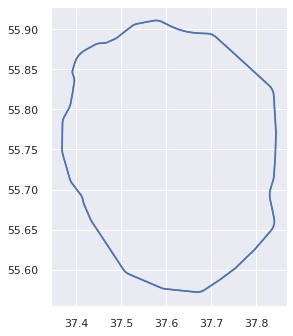

In [81]:
gdf_map['highway_line'].query('MAXSPEED == "100"').plot();

In [82]:
# import matplotlib.pyplot as plt
# from shapely.geometry import MultiPolygon
# from shapely.ops import polygonize, unary_union

# multi = MultiPolygon(list(polygonize(my_gdf.geometry.iloc[0])))
# poly = unary_union(mp)

# ax = my_gdf.geometry.iloc[:1].plot()
# x,y = poly.exterior.xy
# ax.plot(x, y, color="orange")


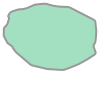

In [83]:
mkad_boundary_polygon = next(polygonize(gdf_map['highway_line'].query('MAXSPEED == "100"').geometry.unary_union))
mkad_boundary_polygon

In [84]:
gdf_map['boundary_L8_inmkad'] = gdf_map['boundary_L8_base'].copy()

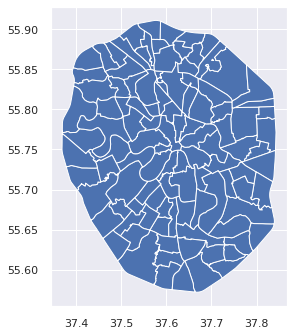

In [85]:
gdf_map['boundary_L8_inmkad'].geometry = gdf_map['boundary_L8_inmkad'].geometry.intersection(mkad_boundary_polygon)
gdf_map['boundary_L8_inmkad'].geometry.plot();

In [86]:
print(gdf_map['boundary_L8_inmkad'].shape)
gdf_map['boundary_L8_inmkad'].drop(
    gdf_map['boundary_L8_inmkad'][gdf_map['boundary_L8_inmkad'].is_empty].index,
    inplace=True
)
print(gdf_map['boundary_L8_inmkad'].shape)

(120, 18)
(108, 18)


In [87]:
gdf_map['boundary_L8_inmkad']['centroid_x'] = gdf_map['boundary_L8_inmkad'].geometry.centroid.x
gdf_map['boundary_L8_inmkad']['centroid_y'] = gdf_map['boundary_L8_inmkad'].geometry.centroid.y
gdf_map['boundary_L8_inmkad']['map_area_km2'] = gdf_map['boundary_L8_inmkad'].geometry.to_crs(MOSCOW_CRS).geometry.area / 10**6

print('mae:', mean_absolute_error(gdf_map['boundary_L8_inmkad']['area_km2_2012'], gdf_map['boundary_L8_inmkad']['map_area_km2']))
print('rmse:', mean_squared_error(gdf_map['boundary_L8_inmkad']['area_km2_2012'], gdf_map['boundary_L8_inmkad']['map_area_km2'], squared=False))

# gdf_map['boundary_L8_inmkad'].to_parquet(str(Path(dirs["cache"], 'moscow_regions_inmkad.parquet')))
# gdf_map['boundary_L8_inmkad'].to_file(str(Path(dirs["cache"], 'moscow_regions_inmkad.geojson')), driver='GeoJSON')
# savepoint()

mae: 0.4365934184870206
rmse: 1.1719892607310214


In [88]:
# test load
# gpd.read_parquet('moscow_regions_inmkad.parquet').plot();
# gpd.read_parquet('moscow_regions_inmkad.parquet').columns.tolist()

### h3

In [89]:
def output_h3_id_attributes(h3_id):
    return {
        "co_ordinates" : h3.h3_to_geo(h3_id), 
        "geo_boundary" : Polygon(h3.h3_to_geo_boundary(h3_id, geo_json=True)).wkt, 
        "parent" : h3.h3_to_parent(h3_id), 
        "children" : h3.h3_to_children(h3_id)
    }

In [90]:
# output_h3_id_attributes('8843acd819fffff')

In [91]:
# h3_id = "8843a13687fffff"
# h3.k_ring(h3_id,1)
# #h3.k_ring(h3_id,2)

#### h3: 7, 8, 9, 10 (11)

In [92]:
gdf_h3 = dict()

In [93]:
# !ls -la cache/moscow_base2_h3_*

In [94]:
min_res, max_res = 10, 7 
for res in range(min_res, max_res-1, -1):
    print(f'{res}'.center(32,'-'))
    if res == min_res:
        gdf_h3[res] = (
            gpd.GeoDataFrame(geometry=gdf_map['base2'])
            .h3.polyfill_resample(
                resolution = res, 
                return_geometry = True,
            )
            .drop(columns='index')
            .assign(h3_n_children=7)
        )
    else:
        gdf_h3[res] = (
            gdf_h3[res+1].h3.h3_to_parent(res)
            .groupby(f'h3_{res:02}')
            .agg({
                'h3_usefull_cell_area_km2': 'sum',
                'h3_n_children': 'count',
            })
            .h3.h3_to_geo_boundary()
        )
    print(f'count: {gdf_h3[res].shape[0]}')
    gdf_h3[res].index.rename('h3_index', inplace=True)
    gdf_h3[res]['h3_parent_index'] = gdf_h3[res].h3.h3_to_parent(res-1)[f'h3_{res-1:02}']
    gdf_h3[res]['h3_res'] = res

    gdf_h3[res]['h3_lat'], gdf_h3[res]['h3_lon'] =  zip(
        *gdf_h3[res].index.to_series().apply(h3.h3_to_geo)
    )
    # gdf_h3[res]['h3_centroid_lon'], gdf_h3[res]['h3_centroid_lat'] =  zip(
    #     *gdf_h3[res].geometry.centroid.apply(lambda s: s.coords[0])
    # )
    # (gdf_h3[res]['h3_geo_lat'] - gdf_h3[res]['h3_centroid_lat']).describe() = 0.0000

    gdf_h3[res]['h3_cell_area_km2'] = gdf_h3[res].index.to_series().apply(h3.cell_area, unit='km^2')
    display(gdf_h3[res]['h3_cell_area_km2'].apply(['mean', 'std', 'min', 'max']))
    #gdf_h3[res]['h3_crs_area_km2'] = gdf_h3[res].geometry.to_crs(MOSCOW_CRS).area / 10**6
    # (gdf_h3[res]['h3_cell_area_km2'] - gdf_h3[res]['h3_crs_area_km2']).describe()
    # # count   1,486.00000
    # # mean       -0.00325
    # # std         0.00001
    # # min        -0.00327
    if res == min_res:
        gdf_h3[res]['h3_usefull_cell_area_km2'] = gdf_h3[res]['h3_cell_area_km2']

    gdf_h3[res]['h3_edge_length_m'] =  np.sqrt(gdf_h3[res]['h3_cell_area_km2']*2/(3*3**.5)) * 1000
    display(gdf_h3[res]['h3_edge_length_m'].apply(['mean', 'std', 'min', 'max']))

    # gdf_h3[res]['h3_edge_length_m'] = gdf_h3[res].index.to_serias().apply(h3.exact_edge_length, unit='m')

    gdf_h3[res] = gdf_h3[res][[
        'h3_parent_index', 'h3_n_children',
        'h3_lat', 'h3_lon',
        'h3_cell_area_km2', 'h3_usefull_cell_area_km2', 
        'h3_edge_length_m', 
        'geometry'
    ]]

    # fn = f'cache/moscow_base2_h3_{res}.geojson'
    # gdf_h3[res].to_file(fn, driver='GeoJSON')
    # !ls -la $fn

---------------10---------------
count: 72945


mean   0.01410
std    0.00003
min    0.01404
max    0.01417
Name: h3_cell_area_km2, dtype: float64

mean   73.66959
std     0.06734
min    73.51529
max    73.84361
Name: h3_edge_length_m, dtype: float64

---------------9----------------
count: 10826


mean   0.09870
std    0.00018
min    0.09829
max    0.09917
Name: h3_cell_area_km2, dtype: float64

mean   194.90926
std      0.18257
min    194.50488
max    195.37212
Name: h3_edge_length_m, dtype: float64

---------------8----------------
count: 1677


mean   0.69087
std    0.00135
min    0.68801
max    0.69419
Name: h3_cell_area_km2, dtype: float64

mean   515.67024
std      0.50501
min    514.60192
max    516.90814
Name: h3_edge_length_m, dtype: float64

---------------7----------------
count: 280


mean   4.83581
std    0.01021
min    4.81548
max    4.85912
Name: h3_cell_area_km2, dtype: float64

mean   1,364.29604
std        1.44085
min    1,361.42579
max    1,367.57996
Name: h3_edge_length_m, dtype: float64

In [95]:
# !zip cache/h3.zip cache/*.geojson
# savepoint()

In [93]:
# h3_7_0 = gdf_h3[7].index[0]
# gdf = gdf_h3[7].query('h3_index == @h3_7_0')
# base = gdf.plot(color='white', edgecolor='red', alpha=.5, linewidth=4, figsize=(12, 12))

# gdf = gdf_h3[8].query(f'h3_parent_index == @h3_7_0')
# gdf.plot(color='white', alpha=.5, edgecolor='blue', linewidth=3, ax=base)

# children_list = gdf.index.tolist()
# gdf = gdf_h3[9].query(f'h3_parent_index in @children_list')
# gdf.plot(color='white', alpha=.5, edgecolor='green', linewidth=2, ax=base)

# children_list = gdf.index.tolist()
# gdf = gdf_h3[10].query(f'h3_parent_index in @children_list')
# gdf.plot(color='white', alpha=.5, edgecolor='black', linewidth=1, ax=base);


### roads



In [94]:
%%time
gdf_roads = reduced_layer(gdf_map, 'highway_line', 'base2')

CPU times: user 11min 7s, sys: 1.15 s, total: 11min 8s
Wall time: 11min 4s


In [ ]:
describe(gdf_roads)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,4134,92.01%,277024,,24047,nan,nan,nan,nan,nan
NAME_EN,object,789,99.00%,298071,,3000,nan,nan,nan,nan,nan
NAME_RU,object,1766,96.98%,291972,,9099,nan,nan,nan,nan,nan
REF,object,112,99.86%,300656,,415,nan,nan,nan,nan,nan
HIGHWAY,object,24,0.00%,0,,301071,nan,nan,bridleway,unclassified,nan
ONEWAY,object,3,91.29%,274845,,26226,nan,nan,nan,nan,nan
BRIDGE,object,5,98.87%,297670,,3401,nan,nan,nan,nan,nan
TUNNEL,object,5,97.06%,292208,,8863,nan,nan,nan,nan,nan
MAXSPEED,object,21,94.59%,284787,,16284,nan,nan,nan,nan,nan
LANES,object,9,87.43%,263241,,37830,nan,nan,nan,nan,nan


#### MAXSPEED

In [95]:
print_value_counts(gdf_roads['MAXSPEED'])

nan - 284787     40 - 819                5 - 483   50 - 104       15 - 13          20;60 - 1
RU:urban - 7057  80 - 799                10 - 230  70 - 52        RU:motorway - 7  68 - 1   
60 - 2718        RU:living_street - 680  30 - 176  110 - 19       3 - 2          
20 - 2416        100 - 557               90 - 134  RU:rural - 15  25 - 1         



#### LANES

In [96]:
print_value_counts(gdf_roads['LANES'])

nan - 263241  1 - 17281  2 - 9638  3 - 4810  4 - 4525  5 - 1203  6 - 326  7 - 37  8 - 8  9 - 2



#### WIDTH

In [97]:
print_value_counts(gdf_roads['WIDTH'])

nan - 296603  2.2 - 36  1.4 - 11   11 - 5    4 m - 2                         9.3 - 1            
1 - 852       7 - 32    2 m - 9    3.2 - 5   10.8 - 2                        4.6 - 1            
2 - 825       2.8 - 31  3.7 - 9    3 m - 5   0.9 - 2                         right side 3.04 - 1
3 - 607       6.5 - 30  7.6 - 8    9 - 4     100 - 2                         8.5 - 1            
1.5 - 373     5.5 - 26  2.7 - 7    3.1 - 4   right- 3.9 m, left - 2.0 m - 2  6.3 - 1            
4 - 327       0.7 - 21  1.0 - 7    1.1 - 4   40 - 2                          80 - 1             
5 - 200       1.8 - 17  12 - 6     1.6 - 4   11.25 - 2                       0.25 - 1           
2.5 - 199     10 - 16   0.75 - 6   7.7 - 4   3.8 - 1                         2.0 - 1            
1.2 - 164     0.4 - 15  0 - 6      7.8 - 4   4.3 - 1                         1.52 - 1           
0.5 - 156     0.3 - 14  3.6 - 6    60 - 3    4.4 - 1                         4.0 - 1            
6 - 83        0.6 - 13  1.5 m 

In [98]:
gdf_roads['WIDTH'] = gdf_roads['WIDTH'].str.replace(r'[^0-9.]', '')

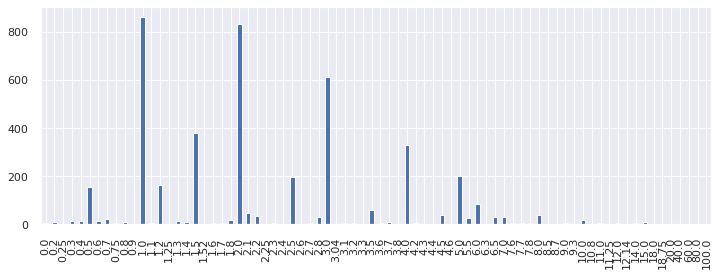

In [99]:
gdf_roads.replace(
    {'WIDTH': {'3.92.0': '6'}},
    inplace=True,
)
gdf_roads['WIDTH'] = gdf_roads['WIDTH'].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('float')
gdf_roads['WIDTH'].value_counts().sort_index().plot.bar(figsize=(12, 4));

#### HIGHWAY

In [100]:
print_value_counts(gdf_roads['HIGHWAY'])

footway - 138910  tertiary - 6953        construction - 967   trunk - 719          raceway - 37  
service - 103343  residential - 4694     cycleway - 851       pedestrian - 517     bridleway - 34
path - 13649      primary - 3580         track - 849          trunk_link - 175     motorway - 25 
steps - 11581     unclassified - 3196    primary_link - 744   living_street - 105  road - 10     
secondary - 7875  secondary_link - 1413  tertiary_link - 743  proposed - 101     



In [101]:
# https://wiki.openstreetmap.org/wiki/RU:Key:highway #'unclassified' 'residential'
main_roads = [
    #'road', 
    'motorway', 
    'primary', 
    'secondary', 
    'trunk', 
    'tertiary', 
    'cycleway', 
    'motorway_link', 
    'primary_link', 
    'secondary_link', 
    'trunk_link', 
    'tertiary_link'
]

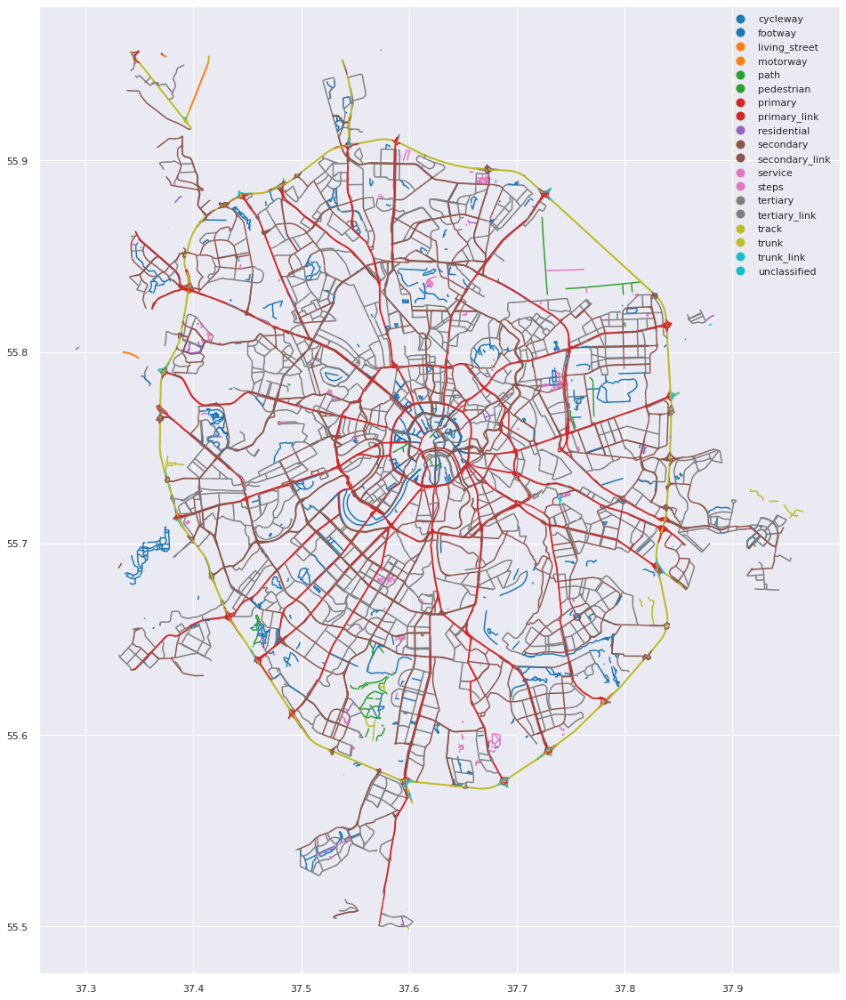

In [ ]:
gdf_roads.query('(HIGHWAY == @main_roads) or (WIDTH > 2)').plot(column='HIGHWAY', legend=True, figsize=(20, 20));
plt.savefig(Path(dirs['img'], 'moscow_roads_HIGHWAY_main_20.png'))

#### outer_auto_gates

In [ ]:
# gdf_roads.query('HIGHWAY == "primary_link"').geometry.touches(gdf_roads.query('MAXSPEED == "100"'))
gdf_map['outer_auto_gates'] = gpd.read_file(fp('source', 'moscow_outer_auto_gate.geojson'))
gdf_map['outer_auto_gates'].explore()

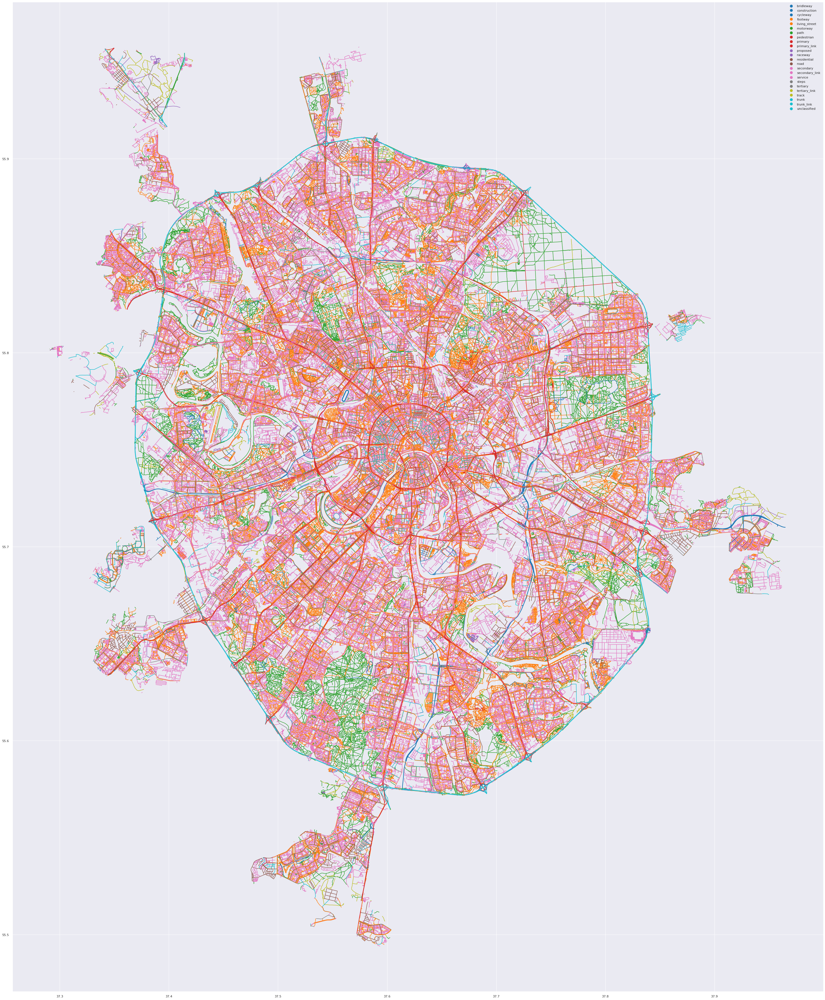

In [ ]:
feature = 'HIGHWAY'
gdf_roads.plot(column=feature, legend=True, figsize=(64, 64))
# plt.savefig(fp('img', 'moscow_roads_HIGHWAY_64.png'))

### railway

In [ ]:
%%time
gdf_railway_line = reduced_layer(gdf_map, 'railway_line', 'base2', mode='intersect')

In [ ]:
%%time
gdf_railway_platform = reduced_layer(gdf_map, 'railway_platform_polygon', 'base2')

In [ ]:
%%time
gdf_railway_station = reduced_layer(gdf_map, 'railway-station-point', 'base2')

In [ ]:
describe(gdf_railway_line)

In [ ]:
describe(gdf_railway_platform)

In [ ]:
describe(gdf_railway_station )

In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
gdf_railway_line.plot(edgecolor='gray', ax=base)
gdf_railway_platform.plot(edgecolor='green', ax=base)
gdf_railway_station.plot(edgecolor='red', linewidth=2, ax=base)
# plt.savefig(Path(dirs['img'], 'moscow_railway_32.png'))
plt.show()

### subway-entrance-point

In [ ]:
%%time
gdf_subway = reduced_layer(gdf_map, 'subway-entrance-point', 'base2')

In [ ]:
describe(gdf_subway)

In [ ]:
gdf_subway.drop(columns='geometry').head(5)

In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(20,20))
gdf_railway_platform.plot(edgecolor='gray', ax=base)
gdf_railway_station.plot(edgecolor='black', linewidth=2, ax=base)
gdf_subway.plot(edgecolor='red', alpha=.5, linewidth=2, ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_railway_subway_20.png'))
plt.show()

### public-transport

In [96]:
%%time
gdf_transport_point = reduced_layer(gdf_map, 'public-transport-point', 'base2')

original [public-transport-point] loaded from zip://source/RU-MOW-ccef5f5b-20221028-ru-shape.zip!data/public-transport-point.shp
CPU times: user 19.7 s, sys: 5.37 ms, total: 19.7 s
Wall time: 19.8 s


In [97]:
%%time
gdf_transport_line = reduced_layer(gdf_map, 'public-transport-line', 'base2')

original [public-transport-line] loaded from zip://source/RU-MOW-ccef5f5b-20221028-ru-shape.zip!data/public-transport-line.shp
CPU times: user 34.8 s, sys: 0 ns, total: 34.8 s
Wall time: 37.5 s


In [98]:
describe(gdf_transport_point)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,4218,3.11%,329,,10248,nan,nan,nan,nan,nan
NAME_EN,object,40,99.29%,10502,,75,nan,nan,nan,nan,nan
NAME_RU,object,66,99.02%,10473,,104,nan,nan,nan,nan,nan
RAILWAY,object,2,91.55%,9683,,894,nan,nan,nan,nan,nan
HIGHWAY,object,3,10.41%,1101,,9476,nan,nan,nan,nan,nan
REF,object,145,98.48%,10416,,161,nan,nan,nan,nan,nan
NETWORK,object,10,99.39%,10512,,65,nan,nan,nan,nan,nan
PUBLIC_TRA,object,3,5.72%,605,,9972,nan,nan,nan,nan,nan
OSM_TYPE,object,1,0.00%,0,,10577,nan,nan,node,node,nan
OSM_ID,int64,10577,0.00%,0,▇█▄▁▂▁▁▁▁▁,10577,2278136688.98251,2049767087.93190,60665302.00000,9589194799.00000,1488759256.00000


##### transport_point

In [99]:
gdf_transport_point.sample(100)

,NAME,NAME_EN,NAME_RU,RAILWAY,HIGHWAY,REF,NETWORK,PUBLIC_TRA,OSM_TYPE,OSM_ID,geometry
7246,Метро «Партизанская»,None,None,None,None,None,None,platform,node,1458596404,POINT (37.75031 55.78654)
4304,Академия тенниса,None,None,None,bus_stop,None,None,platform,node,2506839137,POINT (37.47375 55.67419)
8512,Лихоборская набережная,None,None,None,bus_stop,None,None,None,node,1194502155,POINT (37.51611 55.85266)
6089,Рязанский проспект,None,None,None,bus_stop,None,None,platform,node,1695147874,POINT (37.82962 55.70825)
3134,None,None,None,None,bus_stop,None,None,platform,node,4416591132,POINT (37.52749 55.76125)
11320,Чусовская улица,None,None,None,bus_stop,None,None,platform,node,472577605,POINT (37.81065 55.81043)
368,"Лухмановская улица, 29",None,None,None,bus_stop,None,None,platform,node,1378919807,POINT (37.90544 55.72255)
7539,Новогиреевская улица,None,None,None,bus_stop,None,None,platform,node,1446830897,POINT (37.79365 55.75966)
9507,Терехово,None,None,None,bus_stop,None,None,platform,node,917446131,POINT (37.45089 55.75046)
4152,None,None,None,None,bus_stop,None,None,None,node,2619288192,POINT (37.59685 55.58481)


#### transport_line

In [100]:
describe(gdf_transport_line)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
ROUTE,object,6,0.00%,0,,1929,nan,nan,bus,trolleybus,nan
REF,object,895,0.93%,18,,1911,nan,nan,nan,nan,nan
NAME,object,1769,7.88%,152,,1777,nan,nan,nan,nan,nan
NAME_EN,object,5,99.74%,1924,,5,nan,nan,nan,nan,nan
NAME_RU,object,6,99.69%,1923,,6,nan,nan,nan,nan,nan
FROM,object,824,8.35%,161,,1768,nan,nan,nan,nan,nan
TO,object,807,9.02%,174,,1755,nan,nan,nan,nan,nan
VIA,object,26,98.03%,1891,,38,nan,nan,nan,nan,nan
OPERATOR,object,66,32.19%,621,,1308,nan,nan,nan,nan,nan
NETWORK,object,24,39.24%,757,,1172,nan,nan,nan,nan,nan


In [101]:
gdf_transport_line.drop(columns='geometry').sample()

,ROUTE,REF,NAME,NAME_EN,NAME_RU,FROM,TO,VIA,OPERATOR,NETWORK,NOTE,OSM_TYPE,OSM_ID
91,bus,439,Автобус 439: Горки Ленинские - метро Домодедовская,None,None,Горки Ленинские,"Метро ""Домодедовская""",None,Мострансавто,Москва,None,relation,2727482


##### OPERATOR

In [102]:
print_value_counts(gdf_transport_line['OPERATOR'])

nan - 621                                       Автотрэвэл - 2                                     
ГУП "Мосгортранс" - 529                         Электростальское ПАТП - 2                          
Мосгортранс - 132                               ООО "ГорТакси" - 2                                 
ГУП «Мосгортранс» - 96                          ООО «Ранд-Транс» - 2                               
Мострансавто - 78                               Автоколонна №1786 г.Химки ГУП МО "Мострансавто" - 2
Группа Автолайн - 74                            Химкиэлектротранс - 2                              
Филиал Северо-Восточный ГУП «Мосгортранс» - 64  ООО "КонстантКомпани" - 2                          
Филиал Восточный ГУП «Мосгортранс» - 52         Мосавтотранс - 2                                   
ООО "Трансавтолиз" - 30                         ГУП МО «МОСТРАНСАВТО» - 2                          
Автоколонна 1785 (Мострансавто) - 28            ООО "Альфа-Грант" - 2                              


##### NETWORK

In [103]:
print_value_counts(gdf_transport_line['NETWORK'])

Московский транспорт - 841                                 
nan - 757                                                  
Москва - 83                                                
смежные межрегиональные маршруты (Московская область) - 64 
Московская область - 53                                    
city - 35                                                  
local - 30                                                 
РЖД - 24                                                   
Химки - 6                                                  
смежные межрегиональные маршруты (Москва) - 4              
ru:regional - 4                                            
Московский метрополитен - 4                                
Московский транспорт (смежные межрегиональные маршруты) - 4
Дмитров - 3                                                
regional - 3                                               
Транссибирская магистраль - 2                              
УТЙ - 2                                 

##### ROUTE

In [104]:
print_value_counts(gdf_transport_line['ROUTE'])

bus - 1671  train - 76  share_taxi - 66  tram - 59  subway - 54  trolleybus - 3



##### REF

In [115]:
print_value_counts(gdf_transport_line['REF'])

nan - 18    146 - 2          м86 - 2         281 - 2    257к - 2                           
3 - 11      м89 - 2          Т61 - 2         729 - 2    68 - 2                             
2 - 10      262 - 2          295 - 2         770 - 2    627к - 2                           
9 - 9       648 - 2          53 - 2          830 - 2    198 - 2                            
1 - 9       366 - 2          244 - 2         227 - 2    199о - 2                           
6 - 9       123 - 2          628 - 2         572м - 2   457 - 2                            
361 - 8     191 - 2          606 - 2         695 - 2    908 - 2                            
10 - 7      246 - 2          665 - 2         Т88 - 2    42 - 2                             
142 - 6     е85 - 2          167 - 2         776 - 2    385 - 2                            
14 - 6      698 - 2          33 - 2          237 - 2    644 - 2                            
867 - 6     399 - 2          63 - 2          c839 - 2   291 - 2                 

In [105]:
gdf_transport_line.explore()

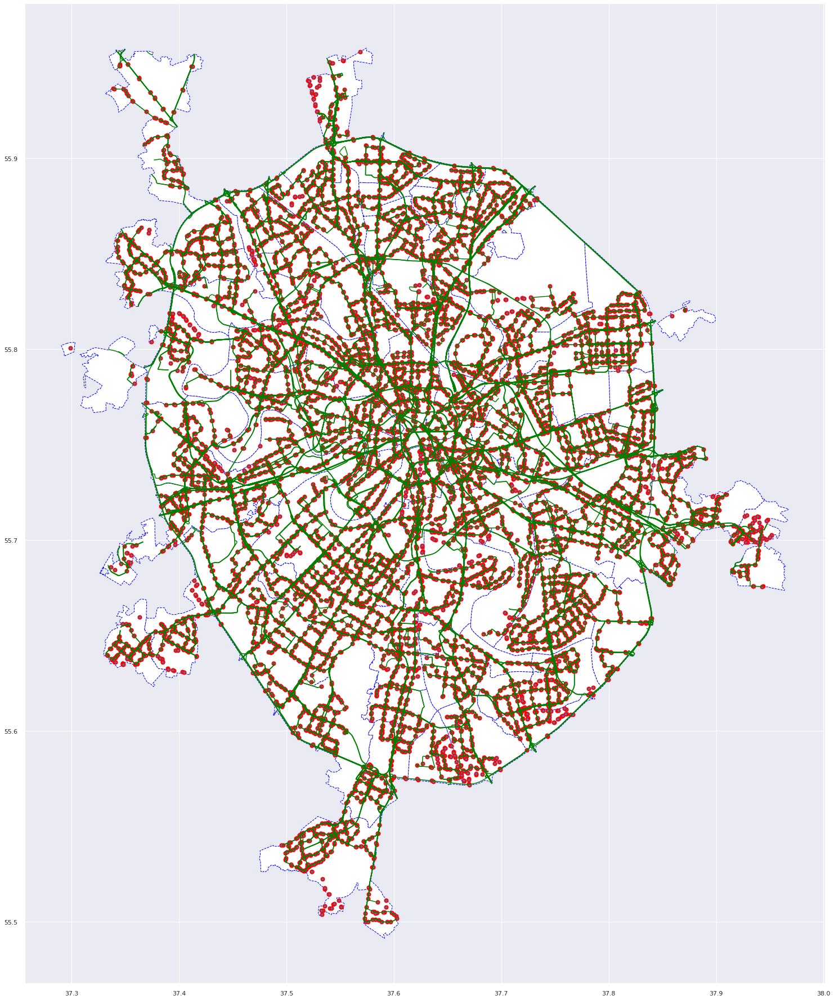

In [106]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
gdf_transport_line.plot(edgecolor='green', ax=base)
gdf_transport_point.plot(edgecolor='red', linewidth=2, ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_transport_32.png'))
plt.show()

In [ ]:
# def close_holes(poly: Polygon) -> Polygon:
#         """
#         Close polygon holes by limitation to the exterior ring.
#         Args:
#             poly: Input shapely Polygon
#         Example:
#             df.geometry.apply(lambda p: close_holes(p))
#         """
#         if poly.interiors:
#             return Polygon(list(poly.exterior.coords))
#         else:
#             return poly

https://github.com/uber/h3/issues/275

In [ ]:
# def covering_cells_from_geometry(geometry, res):
#     """ 
#     :param geometry: pygeos geometry
#     :param res: desired h3 resolution
#     :return: set of h3 indexes
#     """
#     buffer_width = statistics.mean(
#         [
#             h3.exact_edge_length(e, unit="rads")
#             for e in h3.get_h3_unidirectional_edges_from_hexagon(
#                 h3.geo_to_h3(
#                     *pygeos.get_coordinates(pygeos.centroid(geometry))[0][::-1],
#                     resolution=res
#                 )
#             )
#         ]
#     ) * (180 / math.pi)

#     buffered_geometry_parts = pygeos.get_parts(
#         pygeos.buffer(geometry, buffer_width, join_style="mitre")
#     )

#     return reduce(
#         or_,
#         [
#             h3.polyfill_polygon(
#                 pygeos.coordinates.get_coordinates(p),
#                 res=res,
#                 lnglat_order=True,
#             )
#             for p in buffered_geometry_parts
#         ] or [set()],
#     )

## 3

In [ ]:
# def display_hexagons_on_map(hexagons, color="red", width=4, folium_map=None):

#     polylines = []
#     lat = []
#     lng = []
#     for hex in hexagons:
#         polygons = h3.h3_set_to_multi_polygon([hex], geo_json=False)
#         outlines = [loop for polygon in polygons for loop in polygon]
#         polyline = [outline + [outline[0]] for outline in outlines][0]
#         lat.extend(map(lambda v:v[0],polyline))
#         lng.extend(map(lambda v:v[1],polyline))
#         polylines.append(polyline)
    
#     if folium_map is None:
#         m = folium.Map(location=[sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start=20, tiles='cartodbpositron')
#     else:
#         m = folium_map
        
#     for polyline in polylines:
#         my_PolyLine=folium.PolyLine(locations=polyline,weight=width,color=color)
#         m.add_child(my_PolyLine)
#     return m

# loc = (55.83016, 37.6644)
# display_hexagons_on_map([h3.geo_to_h3(*loc, i) for i in range(10, 6, -1)], width=1)

In [ ]:
# display_hexagons_on_map(h3.k_ring(h3.geo_to_h3(*loc, 10), 4), color='blue', width=1)

In [ ]:
# def osm_query(tag, city):
#     gdf = ox.geometries_from_place(city, tag).reset_index()
#     gdf['city'] = np.full(len(gdf), city.split(',')[0])
#     gdf['object'] = np.full(len(gdf), list(tag.keys())[0])
#     gdf['type'] = np.full(len(gdf), tag[list(tag.keys())[0]])
#     gdf = gdf[['city', 'object', 'type', 'geometry']]
#     print(gdf.shape)
#     return gdf
  
# tags = [
#         {'building' : 'apartments'}, {'building' : 'detached'}, 
#         {'building' : 'dormitory'}, {'building' : 'hotel'}, 
#         {'building' : 'house'}, {'building' : 'semidetached_house'}, 
#         {'building' : 'terrace'},  {'building' : 'commercial'},
#         {'building' : 'office'},  {'building' : 'terrace'},  
#         {'building' : 'terrace'}, {'building':'retail'}, 
#         {'building':'train_station'},
#         {'highway' : 'bus_stop'}, {'footway':'crossing'},
#         {'amenity':'cafe'}, {'amenity':'fast_food'}, 
#         {'amenity':'restaurant'}, {'amenity':'college'}, 
#         {'amenity':'language_school'},  {'amenity':'school'},  
#         {'amenity':'university'},  {'amenity':'atm'},  
#         {'amenity':'bank'},  {'amenity':'clinic'},  
#         {'amenity':'hospital'},  {'amenity':'pharmacy'},  
#         {'amenity':'theatre'},  {'amenity':'townhall'},  
#         {'amenity':'bench'}, 
#        ]
# cities = ['Москва, Россия']

# gdfs = []
# for city in cities:
#     for tag in tags:
#         gdfs.append(osm_query(tag, city))
        
# data_poi = pd.concat(gdfs)
# data_poi.groupby(['city','object','type'], as_index = False).agg({'geometry':'count'})

# lat, lon = get_lat_lon(data_poi['geometry'])
# data_poi['lat'] = lat
# data_poi['lon'] = lon

In [ ]:
# # sjoin - spatial join - пересекаем гексагоны с объектами (определяем какие объекты находятся в разрезе каждого гексагона)

# gdf_1 = gpd.GeoDataFrame(data_poi, geometry=gpd.points_from_xy(data_poi.lon, data_poi.lat))

# gdf_2 = pd.DataFrame(polygons, columns = ['geometry'])
# gdf_2['polylines'] = polylines
# gdf_2['geometry'] = gdf_2['geometry'].astype(str)
# geometry_uniq = pd.DataFrame(gdf_2['geometry'].drop_duplicates())
# geometry_uniq['id'] = np.arange(len(geometry_uniq)).astype(str)
# gdf_2 = gdf_2.merge(geometry_uniq, on = 'geometry')
# gdf_2['geometry'] = gdf_2['geometry'].apply(wkt.loads)
# gdf_2 = gpd.GeoDataFrame(gdf_2, geometry='geometry')

# itog_table = gpd.sjoin(gdf_2, gdf_1, how='left', op='intersects')
# itog_table = itog_table.dropna()
# itog_table.head()

In [ ]:
# def create_choropleth(data, json, columns, legend_name, feature, bins):
    
#     lat, lon = get_lat_lon(data['geometry'])

#     m = folium.Map(location=[sum(lat)/len(lat), sum(lon)/len(lon)], zoom_start=13, tiles='cartodbpositron')
    
#     folium.Choropleth(
#         geo_data=json,
#         name="choropleth",
#         data=data,
#         columns=columns,
#         key_on="feature.id",
#         fill_color="YlGn",
#         fill_opacity=0.7,
#         line_opacity=0.2,
#         legend_name=legend_name,
#         nan_fill_color = 'black',
#         bins = bins

#     ).add_to(m)

#     folium.LayerControl().add_to(m)

#     return m
  
# # подготовим данные 
# itog_table['geometry'] = itog_table['geometry'].astype(str) #для groupby
# itog_table['id'] = itog_table['id'].astype(str) #для Choropleth
# agg_all = itog_table.groupby(['geometry','type','id'], as_index = False).agg({'lat':'count'}).rename(columns = {'lat':'counts'})
# agg_all['geometry'] = agg_all['geometry'].apply(wkt.loads) #возвращаем формат геометрий

# agg_all_cafe = agg_all.query("type == 'cafe'")[["geometry","counts",'id']]
# agg_all_cafe['id'] = agg_all_cafe['id'].astype(str)
# data_geo_1 = gpd.GeoSeries(agg_all_cafe.set_index('id')["geometry"]).to_json()

# create_choropleth(agg_all_cafe, data_geo_1, ["id","counts"], 'Cafe counts', 'counts', 5)
   

In [ ]:
# def create_heatmap(data, lat_lon_feature):
    
#     m = folium.Map(location=[sum(data['lat'])/len(data['lat']), sum(data['lon'])/len(data['lon'])], zoom_start=13, tiles='cartodbpositron')
    
#     HeatMap(data[lat_lon_feature].groupby(lat_lon_feature[0:2]).sum().reset_index().values.tolist(), 
#                     radius = 70, min_opacity = 0.05, max_val = int((data[lat_lon_feature[2]]).quantile([0.75])), blur=30).add_to(m)
#     return m
  
# create_heatmap(table_people, ['lat', 'lon', 'count_people'])

## geopandas

In [ ]:
#https://gis.stackexchange.com/questions/222315/finding-nearest-point-in-other-geodataframe-using-geopandas

In [ ]:
# from shapely.geometry import Point, Polygon
# from shapely.ops import nearest_points

# poly = Polygon([(0, 0), (2, 8), (14, 10), (6, 1)])
# point = Point(12, 4)
# # The points are returned in the same order as the input geometries:
# p1, p2 = nearest_points(poly, point)
# print(p1.wkt)
# # POINT (10.13793103448276 5.655172413793103)
# The result is the same as in the other answer:

# from shapely.geometry import LinearRing
# pol_ext = LinearRing(poly.exterior.coords)
# d = pol_ext.project(point)
# p = pol_ext.interpolate(d)
# print(p.wkt)
# # POINT (10.13793103448276 5.655172413793103)
# print(p.equals(p1))
# # True

In [ ]:
# import itertools
# from operator import itemgetter

# import geopandas as gpd
# import numpy as np
# import pandas as pd

# from scipy.spatial import cKDTree
# from shapely.geometry import Point, LineString

# gpd1 = gpd.GeoDataFrame([['John', 1, Point(1, 1)],
#                          ['Smith', 1, Point(2, 2)],
#                          ['Soap', 1, Point(0, 2)]],
#                         columns=['Name', 'ID', 'geometry'])
# gpd2 = gpd.GeoDataFrame([['Work', LineString([Point(100, 0), Point(100, 1)])],
#                          ['Shops', LineString([Point(101, 0), Point(101, 1), Point(102, 3)])],
#                          ['Home',  LineString([Point(101, 0), Point(102, 1)])]],
#                         columns=['Place', 'geometry'])


# def ckdnearest(gdfA, gdfB, gdfB_cols=['Place']):
#     # resetting the index of gdfA and gdfB here.
#     gdfA = gdfA.reset_index(drop=True)
#     gdfB = gdfB.reset_index(drop=True)
#     A = np.concatenate(
#         [np.array(geom.coords) for geom in gdfA.geometry.to_list()])
#     B = [np.array(geom.coords) for geom in gdfB.geometry.to_list()]
#     B_ix = tuple(itertools.chain.from_iterable(
#         [itertools.repeat(i, x) for i, x in enumerate(list(map(len, B)))]))
#     B = np.concatenate(B)
#     ckd_tree = cKDTree(B)
#     dist, idx = ckd_tree.query(A, k=1)
#     idx = itemgetter(*idx)(B_ix)
#     gdf = pd.concat(
#         [gdfA, gdfB.loc[idx, gdfB_cols].reset_index(drop=True),
#          pd.Series(dist, name='dist')], axis=1)
#     return gdf

# c = ckdnearest(gpd1, gpd2)

In [ ]:
# from shapely.ops import nearest_points
# # unary union of the gpd2 geomtries 
# pts3 = gpd2.geometry.unary_union
# def near(point, pts=pts3):
#      # find the nearest point and return the corresponding Place value
#      nearest = gpd2.geometry == nearest_points(point, pts)[1]
#      return gpd2[nearest].Place.get_values()[0]
# gpd1['Nearest'] = gpd1.apply(lambda row: near(row.geometry), axis=1)
# gpd1
# #     Name  ID     geometry  Nearest
# # 0   John   1  POINT (1 1)     Home
# # 1  Smith   1  POINT (2 2)    Shops
# # 2   Soap   1  POINT (0 2)     Work
# Explication

# for i, row in gpd1.iterrows():
#     print nearest_points(row.geometry, pts3)[0], nearest_points(row.geometry, pts3)[1]
# #  POINT (1 1) POINT (1 1.1)
# #  POINT (2 2) POINT (2.5 2)
# #  POINT (0 2) POINT (0 1.1)

# faq
- [H3: Area Variation](https://observablehq.com/@nrabinowitz/h3-area-variation)

## libs
- https://geojson.io/#map=15.47/55.827892/37.662938
- osmnx
    - https://osmnx.readthedocs.io/en/stable/osmnx.html
- h3
    - https://h3geo.org/docs/api/indexing
    - https://github.com/uber/h3-py-notebooks/tree/master/notebooks
    - https://github.com/uber/h3-py-notebooks/blob/master/notebooks/urban_analytics.ipynb
- H3Pandas
    - https://github.com/DahnJ/H3-Pandas
    - https://h3-pandas.readthedocs.io/en/latest/h3pandas.html
    - https://nbviewer.org/github/DahnJ/H3-Pandas/blob/master/notebook/00-intro.ipynb
    - https://github.com/DahnJ/H3-Pandas/blob/master/notebook/01-unified-data-layers.ipynb
    - https://h3-pandas.readthedocs.io/en/latest/notebook/01-unified-data-layers.html

- https://jakevdp.github.io/PythonDataScienceHandbook/01.07-timing-and-profiling.html